In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import re
import scanpy.external as sce
import parc
import sys
import scrublet as scr
import glob

import warnings

In [3]:
scrublet_thresh_dict = {'LHCC35_Control_CD45': 0.275,
                        'LHCC35_Core_CD45': 0.18,
                        'LHCC35_Rim_CD45': 0.18,
                        'LHCC44_Control_CD45': 0.205,
                        'LHCC44_Core_CD45': 0.185,
                        'LHCC45_Control_CD45': 0.218,
                        'LHCC45_Core_CD45': 0.22,
                        'LHCC46_Control_CD45': 0.252,
                        'LHCC46_Core_CD45': 0.21,
                        'LHCC46_Rim_CD45': 0.151,
                        'LHCC47_Control_CD45': 0.21,
                        'LHCC47_Core_CD45': 0.203,
                        'LHCC48_Control_CD45': 0.2,
                        'LHCC48_Core_CD45': 0.17,
                        'LHCC54_Control_CD45': 0.18,
                        'LHCC54_Core_CD45': 0.16,
                        'Pat52_Control_CD45': 0.218,
                        'Pat52_Core_CD45': 0.23}

In [4]:
patient_lst = ["LHCC35", "LHCC44", "LHCC45", "LHCC46", "LHCC47", "LHCC48", "LHCC54", "Pat52"]

adata_lst = []
foo_ct = 0

with warnings.catch_warnings():
    warnings.filterwarnings("ignore")
    for patient in patient_lst:
        for file in glob.glob(f"scRNA-seq/Matrix_files/CD45/*{patient}*.h5"):
            file_string = file[28:].split("_")
            tissue = file_string[1]
            sample = f"{patient}_{tissue}_CD45"

            partial_adata = sc.read_10x_h5(file)
            partial_adata.var_names_make_unique()
            partial_adata.obs["Patient"] = patient
            partial_adata.obs["Tissue"] = tissue
            partial_adata.obs["Sample"] = sample

            df_tcr = pd.read_csv(f"scRNA-seq/Matrix_files/TCR-seq/CD45/{sample}_filtered_contig_annotations.csv")
            mait_barcodes = df_tcr.loc[(df_tcr["v_gene"] == "TRAV1-2") &
                             (df_tcr["j_gene"].isin(["TRAJ33", "TRAJ20", "TRAJ12"]))]["barcode"]

            shared_barcodes = list(set(partial_adata.obs.index.to_list()).intersection(mait_barcodes))
            foo_ct += len(shared_barcodes)
            partial_adata.obs["TCR"] = "Not-MAIT"
            partial_adata.obs.loc[shared_barcodes, "TCR"] = "MAIT"
            
            exp_per_doublet = 0.00076*partial_adata.n_obs/ 100
            print(16*"- ")
            print(sample)
            
            #print(f"Size: {partial_adata.n_obs}")
            #print("NN:", np.round(0.5 * np.sqrt(partial_adata.n_obs)))
            #print(f"Expected percentage: {exp_per_doublet*100}")
            
            sce.pp.scrublet(partial_adata, verbose=False, n_neighbors=None, use_approx_neighbors=False, threshold=scrublet_thresh_dict[sample])
                      
            print("Detected percentage:", partial_adata.obs.predicted_doublet.value_counts(True)[True]*100)
            #sce.pl.scrublet_score_distribution(partial_adata)

            adata_lst.append(partial_adata)
        
adata = adata_lst[0].concatenate(adata_lst[1:])
print(adata.obs['predicted_doublet'].value_counts())
adata = adata[~adata.obs["predicted_doublet"]]
"""

- - - - - - - - - - - - - - - - 
LHCC35_Control_CD45
Detected percentage: 1.4865407794294898
- - - - - - - - - - - - - - - - 
LHCC35_Rim_CD45
Detected percentage: 1.4506317267197004
- - - - - - - - - - - - - - - - 
LHCC35_Core_CD45
Detected percentage: 2.3093957608351787
- - - - - - - - - - - - - - - - 
LHCC44_Control_CD45
Detected percentage: 3.166769483857701
- - - - - - - - - - - - - - - - 
LHCC44_Core_CD45
Detected percentage: 3.889789303079417
- - - - - - - - - - - - - - - - 
LHCC45_Control_CD45
Detected percentage: 2.9458418309539995
- - - - - - - - - - - - - - - - 
LHCC45_Core_CD45
Detected percentage: 3.378665533361666
- - - - - - - - - - - - - - - - 
LHCC46_Rim_CD45
Detected percentage: 10.420529555736854
- - - - - - - - - - - - - - - - 
LHCC46_Core_CD45
Detected percentage: 5.3504910260751775
- - - - - - - - - - - - - - - - 
LHCC46_Control_CD45
Detected percentage: 2.8287461773700304
- - - - - - - - - - - - - - - - 
LHCC47_Control_CD45
Detected percentage: 4.220338983050848
-

/Users/matthias/miniconda3/envs/maitRev/lib/python3.9/site-packages/anndata/_core/anndata.py:1785: FutureWarning: X.dtype being converted to np.float32 from float64. In the next version of anndata (0.9) conversion will not be automatic. Pass dtype explicitly to avoid this warning. Pass `AnnData(X, dtype=X.dtype, ...)` to get the future behavour.
  [AnnData(sparse.csr_matrix(a.shape), obs=a.obs) for a in all_adatas],


False    99521
True      5176
Name: predicted_doublet, dtype: int64


## Import

In [5]:
adata.write("scRNA-seq/Redone22/CD45/CD45_Scrublet.h5ad")

In [7]:
print(f"Cells in raw data: {adata.n_obs}")

Cells in raw data: 99521


## Preprocessing

In [8]:
# Quality control - calculate QC covariates
adata.obs['n_counts'] = adata.X.sum(1)
adata.obs['log_counts'] = np.log(adata.obs['n_counts'])
adata.obs['n_genes'] = (adata.X > 0).sum(1)

adata.var["mt"] = adata.var_names.str.startswith("MT-")
adata.var["ribo"] = adata.var_names.str.startswith(("RPS", "RPL"))
adata.var["hb"] = adata.var_names.str.contains(("^HB[^(P)]"))

mito_genes = adata.var_names.str.startswith("MT-")

In [9]:
sc.pp.calculate_qc_metrics(adata, qc_vars=["mt", "ribo", "hb"], percent_top=[50], log1p=True, inplace=True)

In [10]:
sc.set_figure_params(scanpy=True, dpi=150, dpi_save=150, frameon=True, vector_friendly=True, fontsize=6, figsize=(6,4), color_map=None, format='pdf', facecolor=None, transparent=False, ipython_format='png2x')

In [11]:
def is_outlier(adata, metric: str, nmads: int):
    M = adata.obs[metric]
    outlier = (M < np.median(M) - nmads * M.mad()) | (
        np.median(M) + nmads * M.mad() < M
    )
    return outlier

In [12]:
adata.obs["outlier"] = (
    is_outlier(adata, "log1p_total_counts", 5)
    | is_outlier(adata, "log1p_n_genes_by_counts", 5)
    | is_outlier(adata, "pct_counts_in_top_50_genes", 5)
)
adata.obs.outlier.value_counts()

/var/folders/bj/fj47mx516_gc9y60blmf_5yr0000gn/T/ipykernel_77866/430617275.py:3: FutureWarning: The 'mad' method is deprecated and will be removed in a future version. To compute the same result, you may do `(df - df.mean()).abs().mean()`.
  outlier = (M < np.median(M) - nmads * M.mad()) | (
/var/folders/bj/fj47mx516_gc9y60blmf_5yr0000gn/T/ipykernel_77866/430617275.py:4: FutureWarning: The 'mad' method is deprecated and will be removed in a future version. To compute the same result, you may do `(df - df.mean()).abs().mean()`.
  np.median(M) + nmads * M.mad() < M


False    98256
True      1265
Name: outlier, dtype: int64

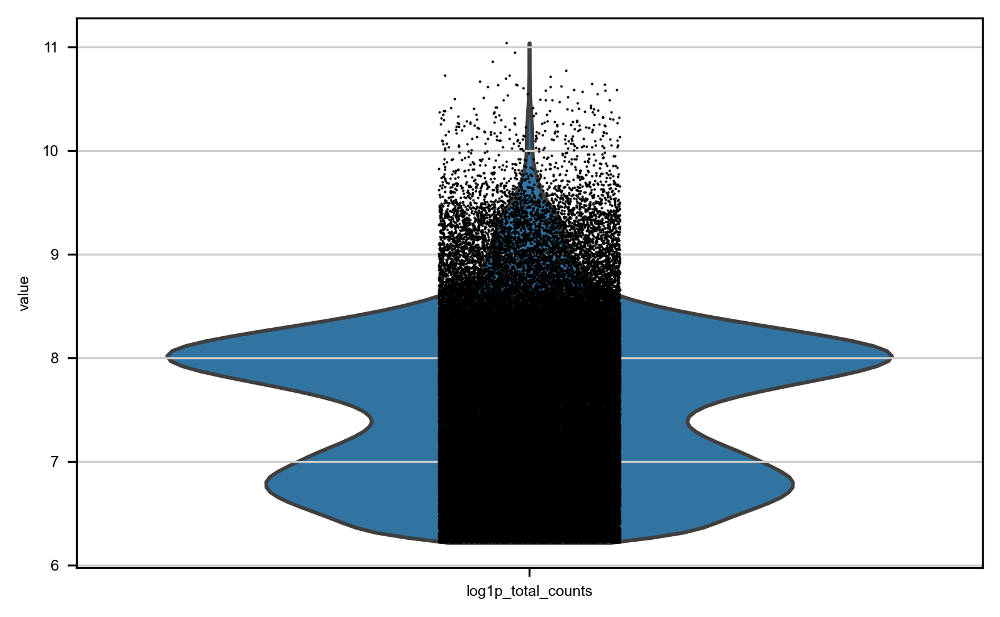

In [ ]:
sc.pl.violin(adata, keys=["log1p_total_counts"])

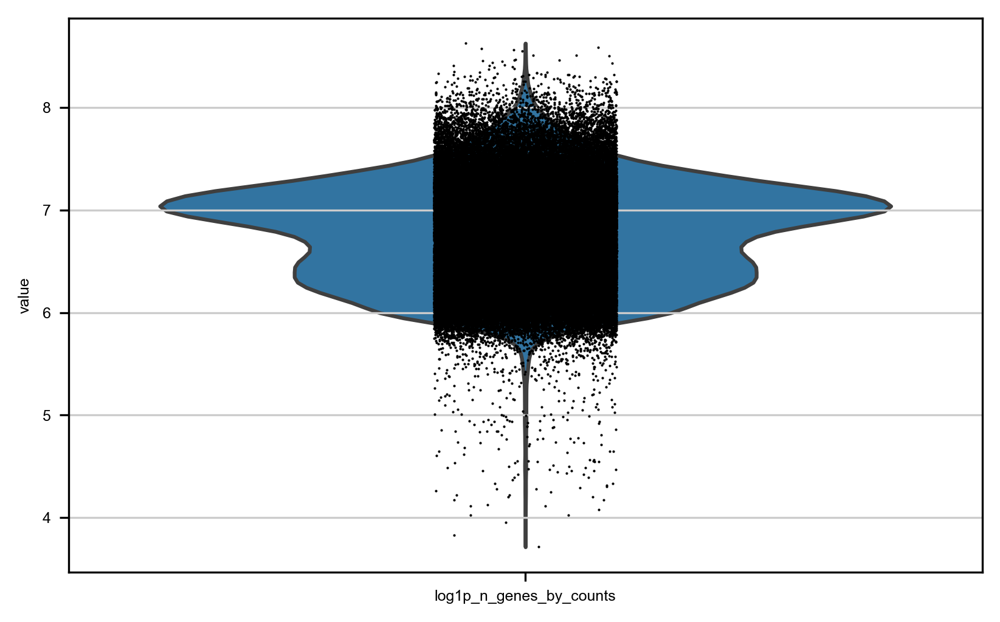

In [ ]:
sc.pl.violin(adata, keys=["log1p_n_genes_by_counts"])

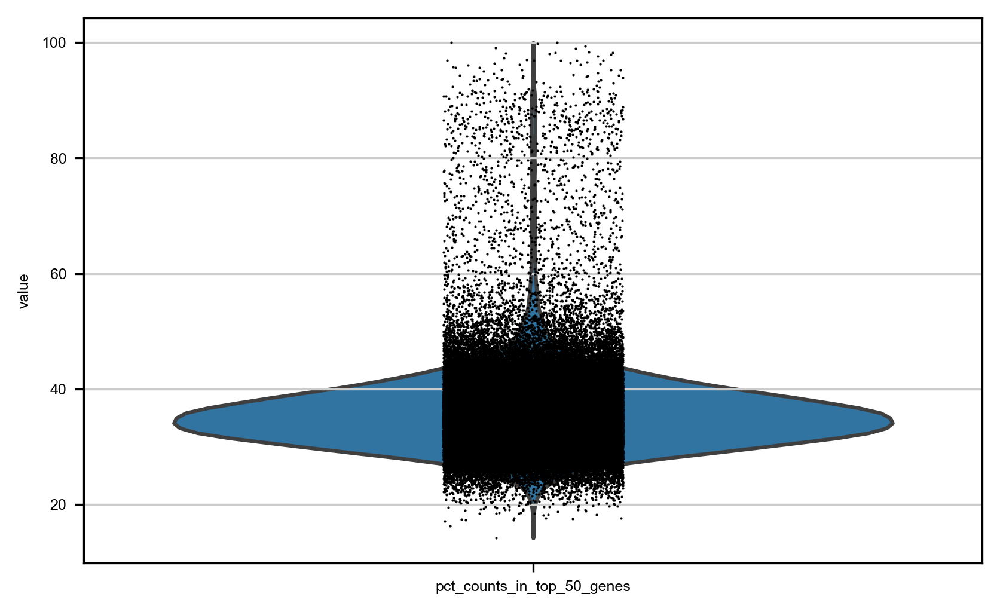

In [ ]:
sc.pl.violin(adata, keys=["pct_counts_in_top_50_genes"])

In [16]:
print(adata.shape)
adata = adata[(~adata.obs.outlier)]
print(adata.shape)

(99521, 36601)
(98256, 36601)


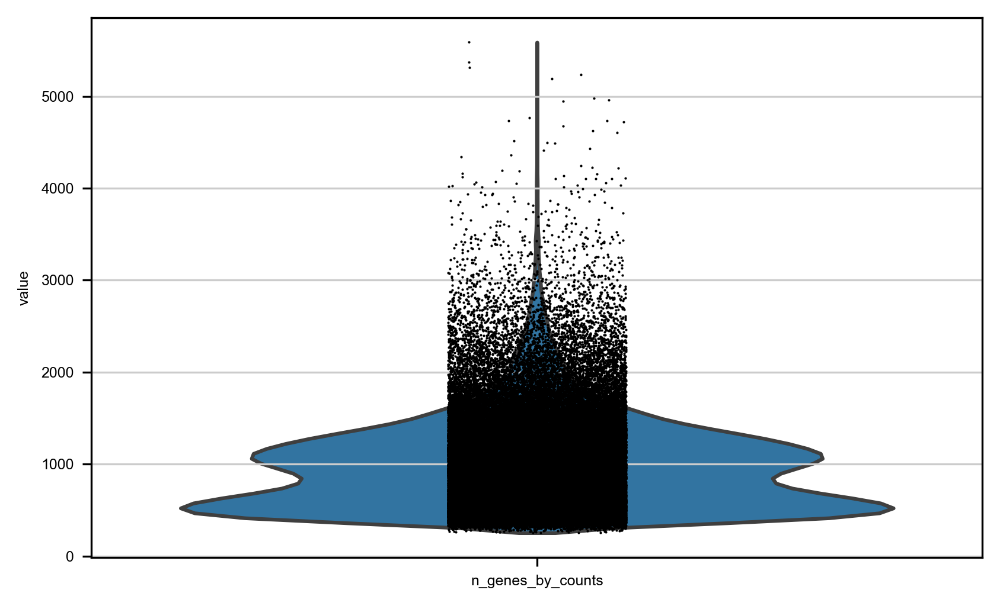

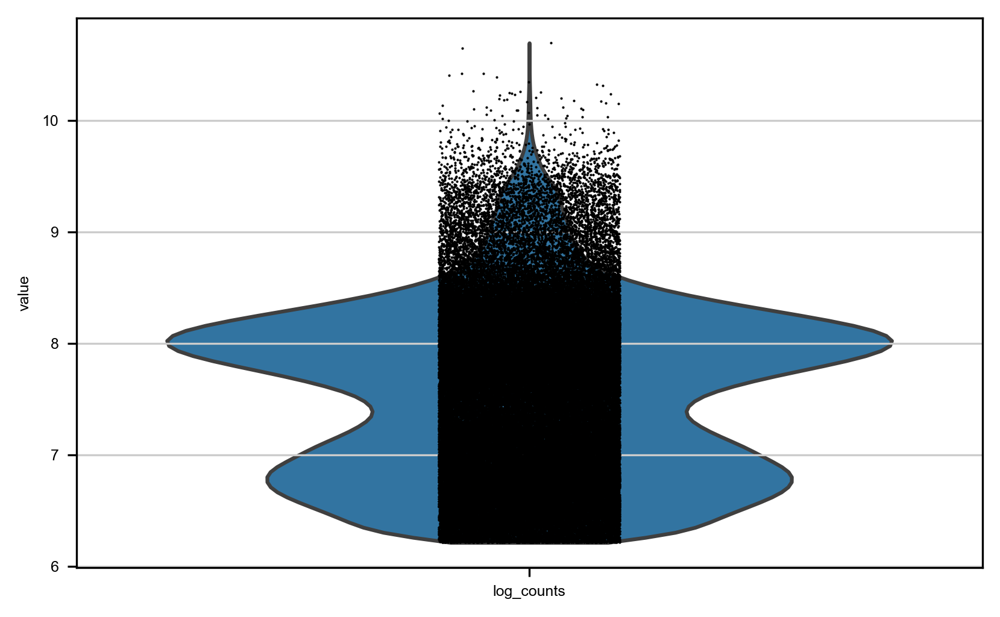

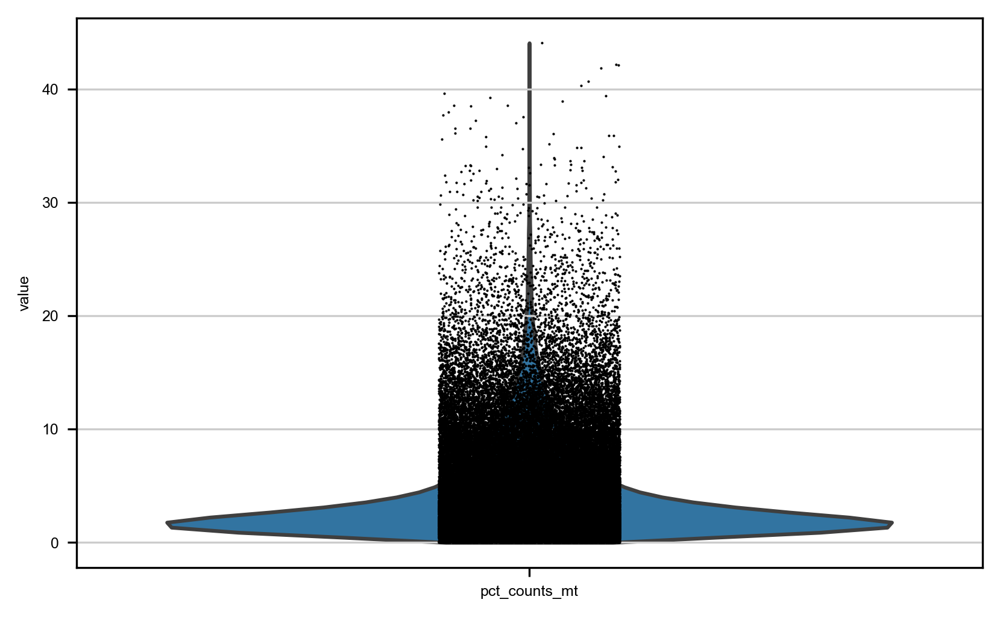

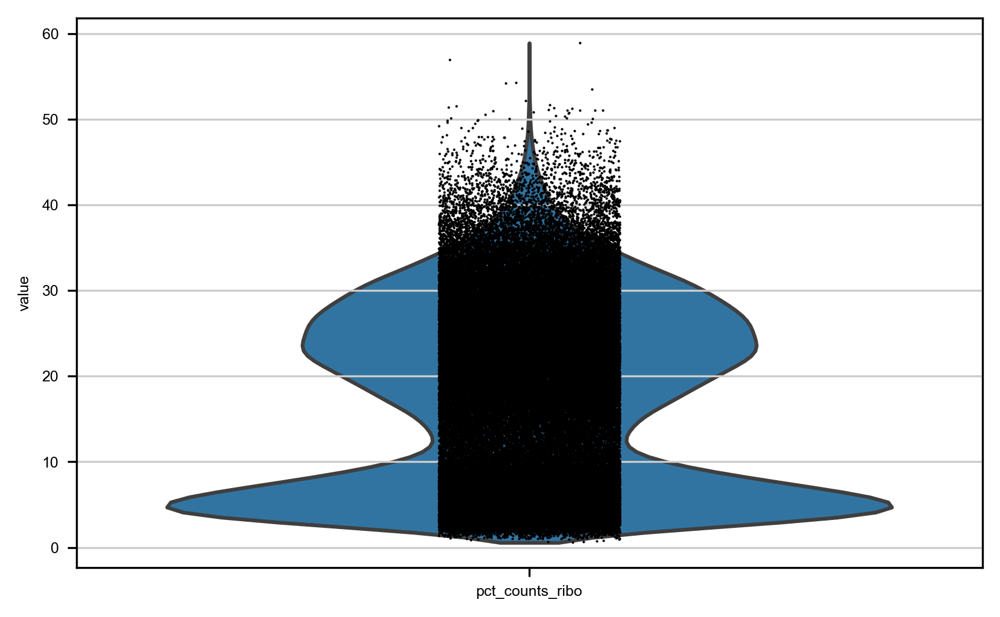

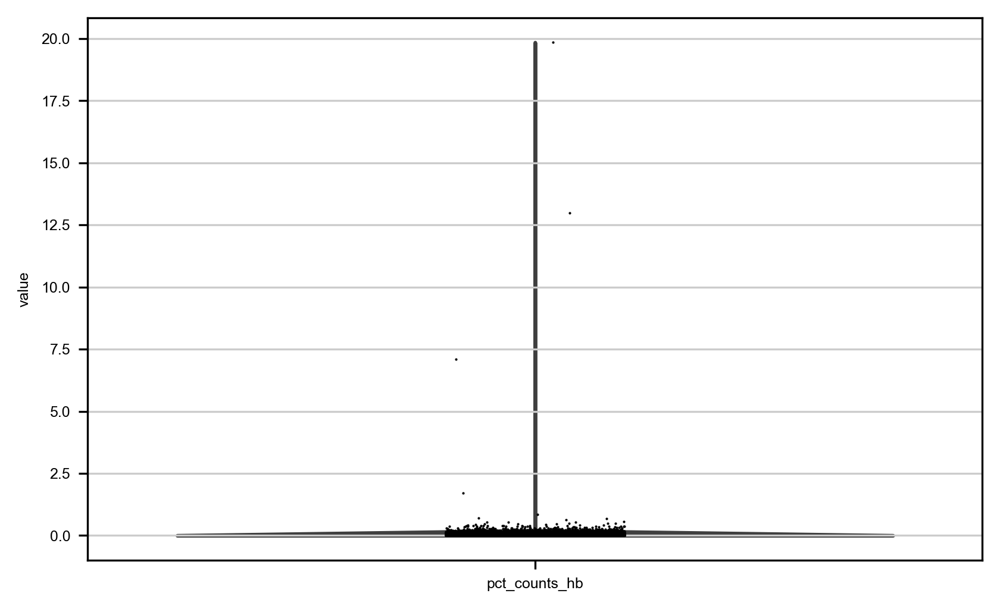

In [17]:
for e in ["n_genes_by_counts", "log_counts", "pct_counts_mt", "pct_counts_ribo", "pct_counts_hb"]:
    sc.pl.violin(adata, e)

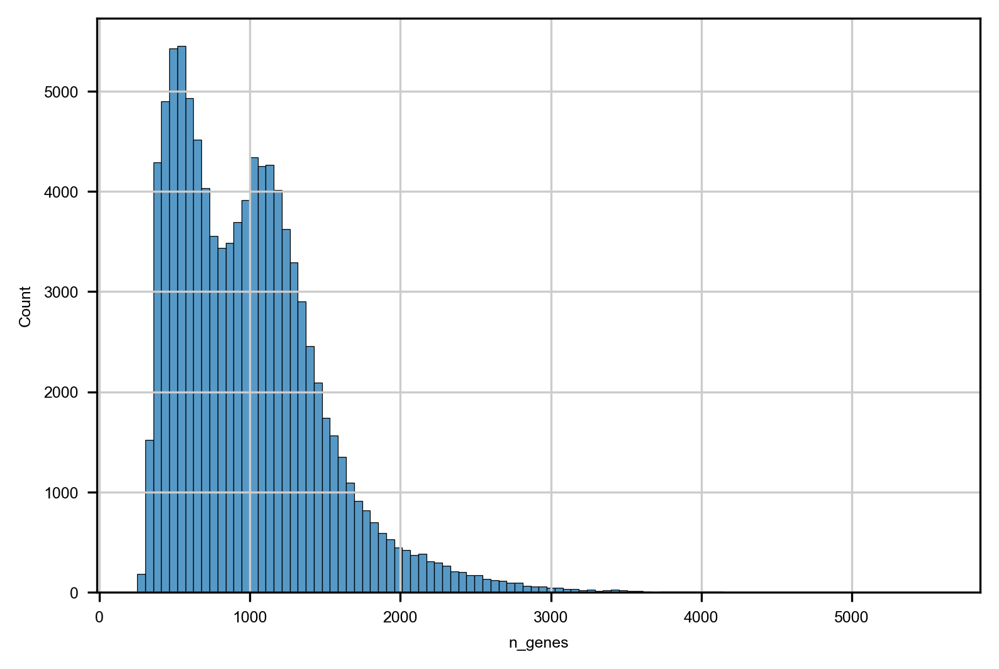

In [18]:
sns.histplot(adata.obs['n_genes'], kde=False, bins=100)
plt.show()

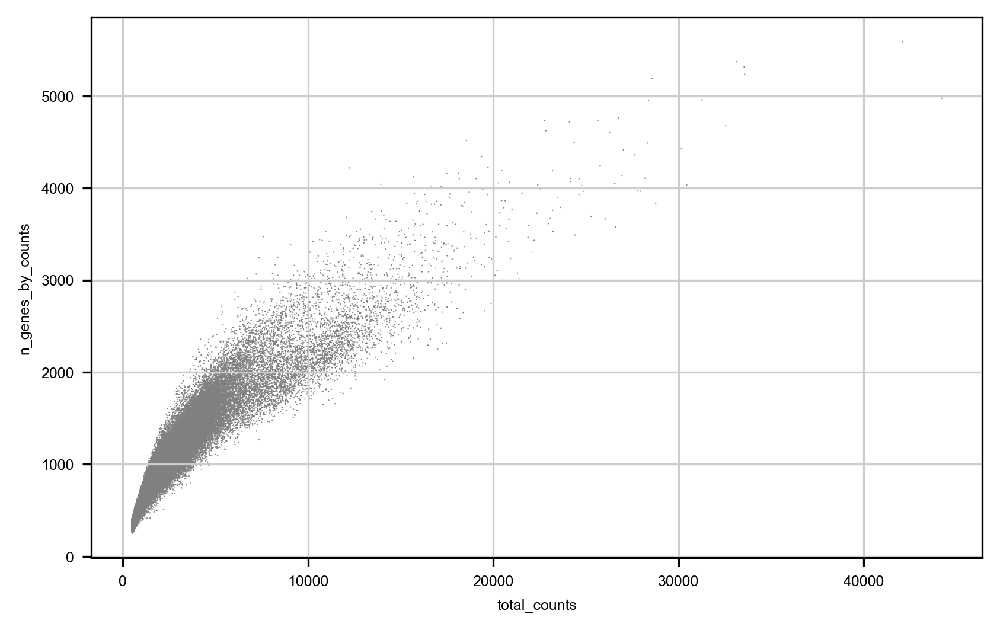

In [19]:
sc.pl.scatter(adata, x='total_counts', y='n_genes_by_counts')

In [20]:
print(adata.shape)
adata = adata[adata.obs.n_genes_by_counts < 3000, :]
print(adata.shape)

(98256, 36601)
(97865, 36601)


In [21]:
adata = adata[adata.obs["pct_counts_mt"] < 3]
print(f"Number of cells after MT filter: {adata.n_obs}")

adata = adata[adata.obs["pct_counts_ribo"] > 15]
print(f'Number of cells after RIBO filter: {adata.n_obs}')

adata = adata[adata.obs["pct_counts_hb"] < 0.2, :]
print(f"Number of cells after HB filter: {adata.n_obs}")

Number of cells after MT filter: 53960
Number of cells after RIBO filter: 44601
Number of cells after HB filter: 44570


In [22]:
# Filter cells according to identified QC thresholds:
print(f"Total number of cells: {adata.n_obs}")

sc.pp.filter_cells(adata, min_genes=200)
print(f"Number of cells after gene filter: {adata.n_obs}")
# 20
sc.pp.filter_genes(adata, min_cells=20)
print(f"Number of genes after cell filter: {adata.n_vars}")

Total number of cells: 44570


/Users/matthias/miniconda3/envs/maitRev/lib/python3.9/site-packages/scanpy/preprocessing/_simple.py:140: ImplicitModificationWarning: Trying to modify attribute `.obs` of view, initializing view as actual.
  adata.obs['n_genes'] = number


Number of cells after gene filter: 44570
Number of genes after cell filter: 17220


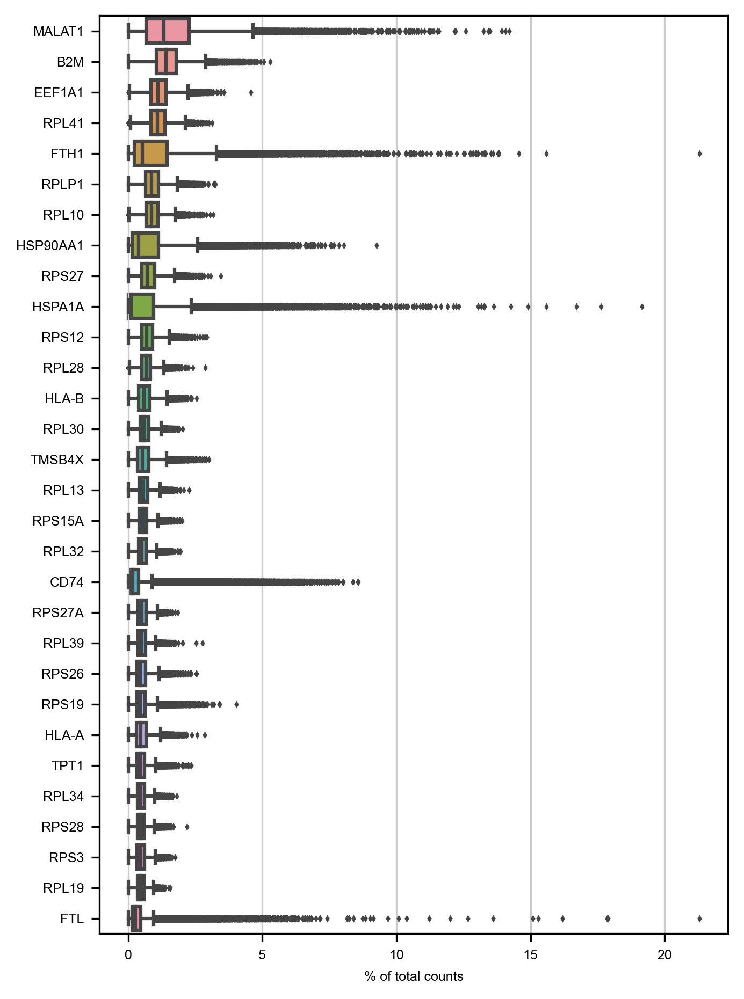

In [23]:
sc.pl.highest_expr_genes(adata, n_top=30, log=False)

In [24]:
malat1 = adata.var_names.str.startswith("MALAT1")

mito_genes = adata.var_names.str.startswith("MT-")
ribo_genes = adata.var_names.str.contains(("^RP[SL]"))
hb_genes = adata.var_names.str.contains("^HB[^(P)]")


remove = np.add(mito_genes, malat1)
remove = np.add(remove, ribo_genes)
remove = np.add(remove, hb_genes)

keep = np.invert(remove)

adata = adata[:, keep]

/Users/matthias/miniconda3/envs/maitRev/lib/python3.9/site-packages/scanpy/preprocessing/_normalization.py:170: UserWarning: Received a view of an AnnData. Making a copy.
  view_to_actual(adata)


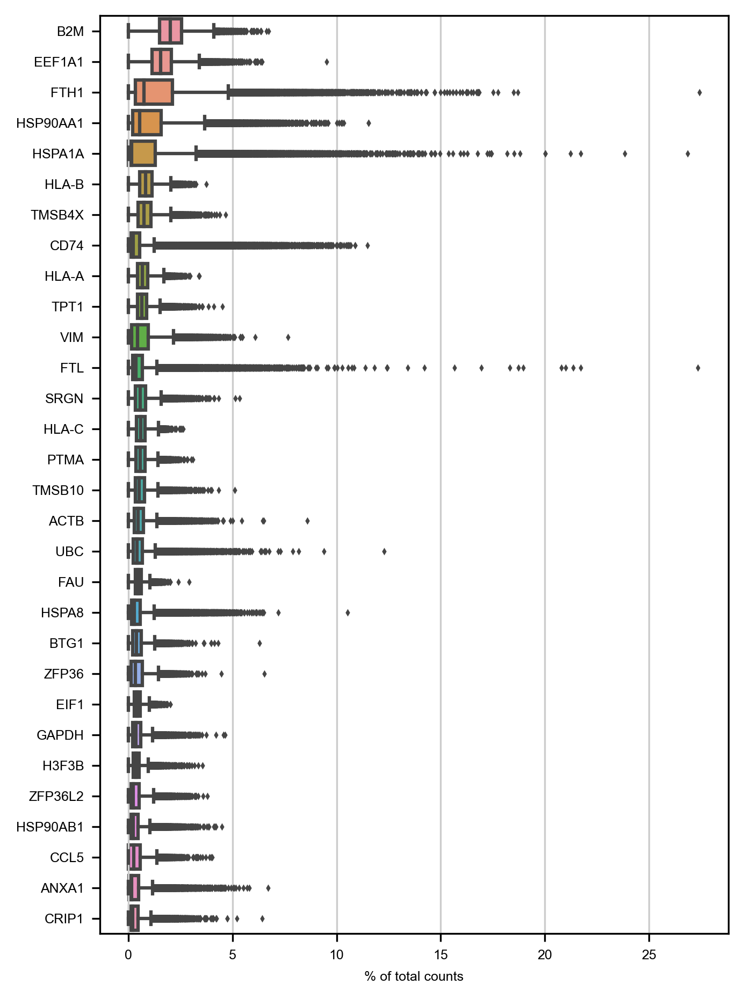

In [25]:
sc.pl.highest_expr_genes(adata, n_top=30, log=False)

In [26]:
sc.pp.normalize_total(adata, target_sum=1e4)
sc.pp.log1p(adata)
adata.raw = adata
sc.pp.highly_variable_genes(adata)

## Normalize, Log1p, HVG
HVG is done by providing a key. Is this helpful?

In [27]:
sc.pp.scale(adata)

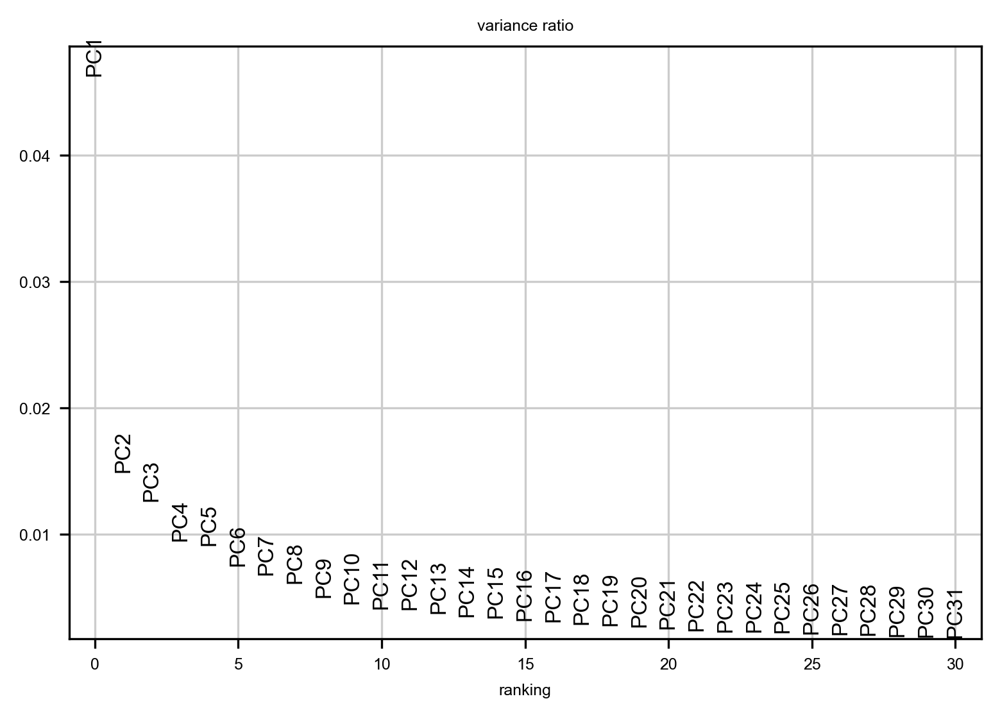

In [28]:
sc.pp.pca(adata, n_comps=50, use_highly_variable=True)
sc.pl.pca_variance_ratio(adata, n_pcs=30, log=False, show=None, save=None)

In [29]:
sce.pp.harmony_integrate(adata, "Patient", max_iter_harmony=50, adjusted_basis="X_pca")

2023-02-10 17:44:48,242 - harmonypy - INFO - Computing initial centroids with sklearn.KMeans...
2023-02-10 17:45:01,758 - harmonypy - INFO - sklearn.KMeans initialization complete.
2023-02-10 17:45:01,849 - harmonypy - INFO - Iteration 1 of 50
2023-02-10 17:45:08,633 - harmonypy - INFO - Iteration 2 of 50
2023-02-10 17:45:15,523 - harmonypy - INFO - Iteration 3 of 50
2023-02-10 17:45:22,521 - harmonypy - INFO - Converged after 3 iterations


In [31]:
sc.pp.neighbors(adata, n_neighbors=30, n_pcs=20,random_state=0)

In [32]:
sc.tl.umap(adata,random_state=0)

/Users/matthias/miniconda3/envs/maitRev/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/Users/matthias/miniconda3/envs/maitRev/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


/Users/matthias/miniconda3/envs/maitRev/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


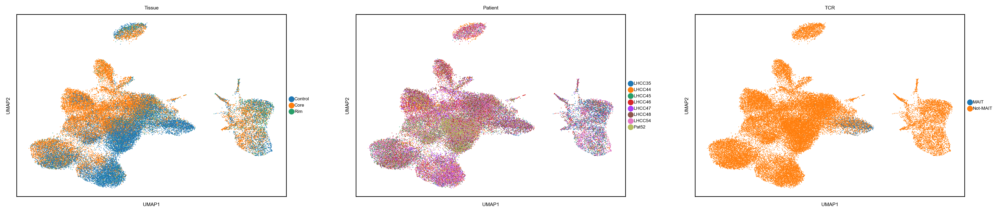

In [33]:
sc.pl.umap(adata, color=["Tissue", "Patient", "TCR"], save="_Tissue_Patient_TCR_CD45.pdf")
plt.show()

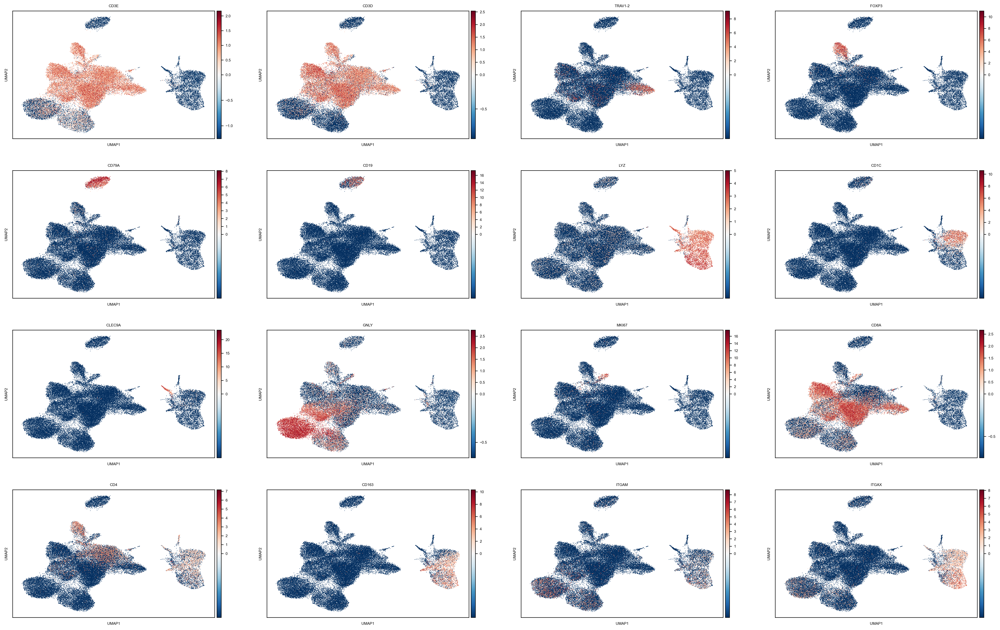

In [34]:
plot_genes = ["CD3E", "CD3D", "TRAV1-2", "FOXP3", "CD79A", "CD19", "LYZ", "CD1C", "CLEC9A", "GNLY", "MKI67", "CD8A", "CD4", "CD163", "ITGAM", "ITGAX"]
sc.pl.umap(adata, color=plot_genes, save="_CD45_marker.pdf", use_raw=False, vcenter=0, cmap="RdBu_r")
plt.show()

/Users/matthias/miniconda3/envs/maitRev/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


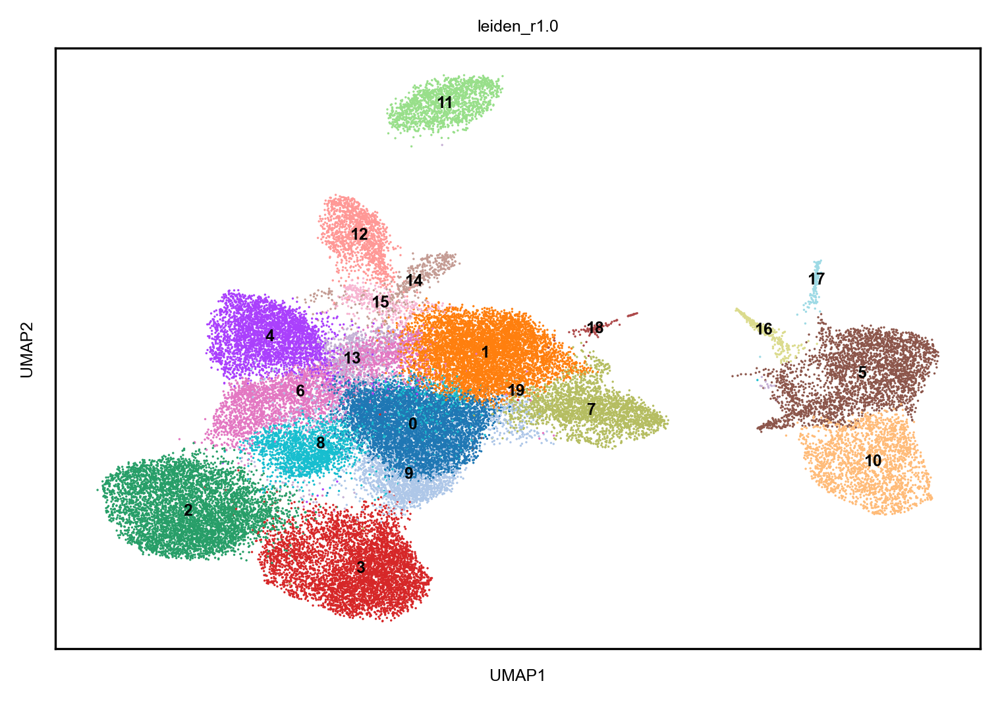

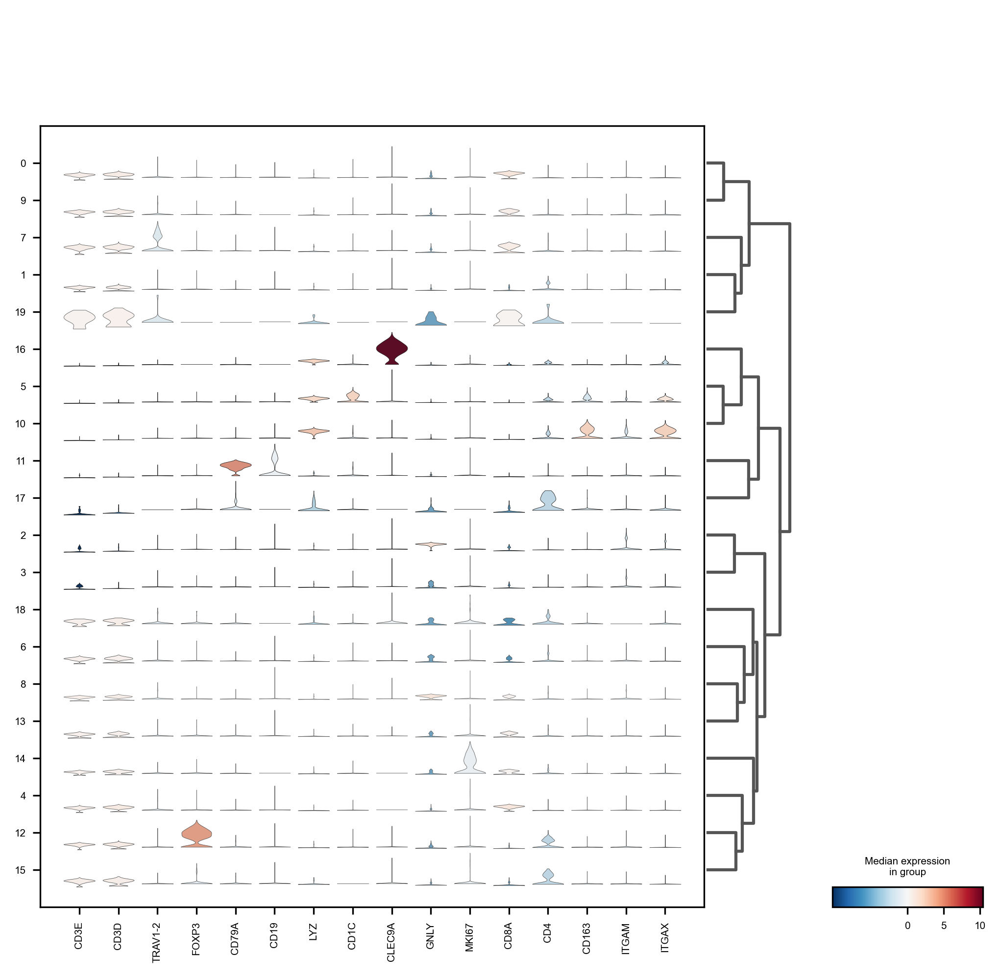

/Users/matthias/miniconda3/envs/maitRev/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


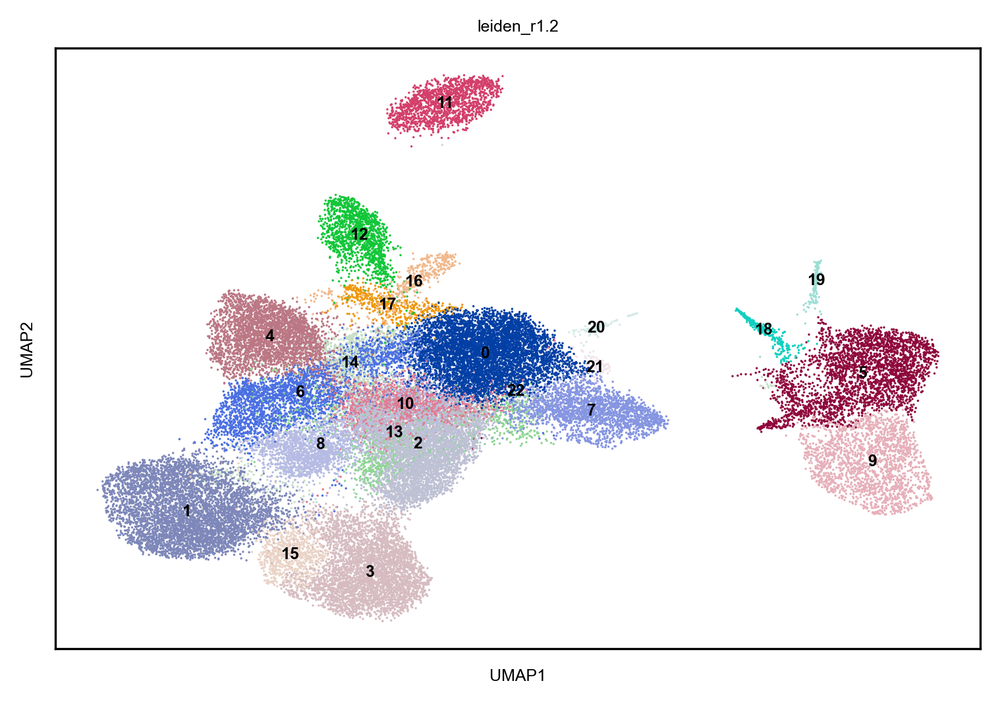

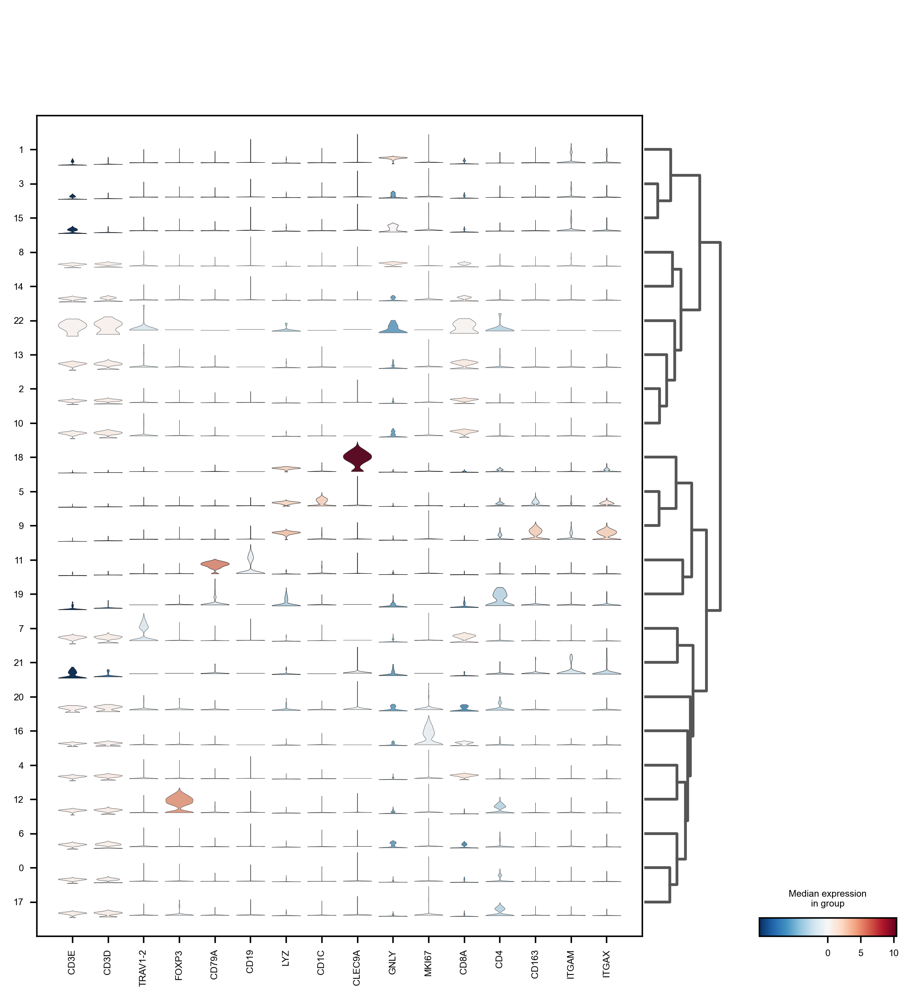

/Users/matthias/miniconda3/envs/maitRev/lib/python3.9/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


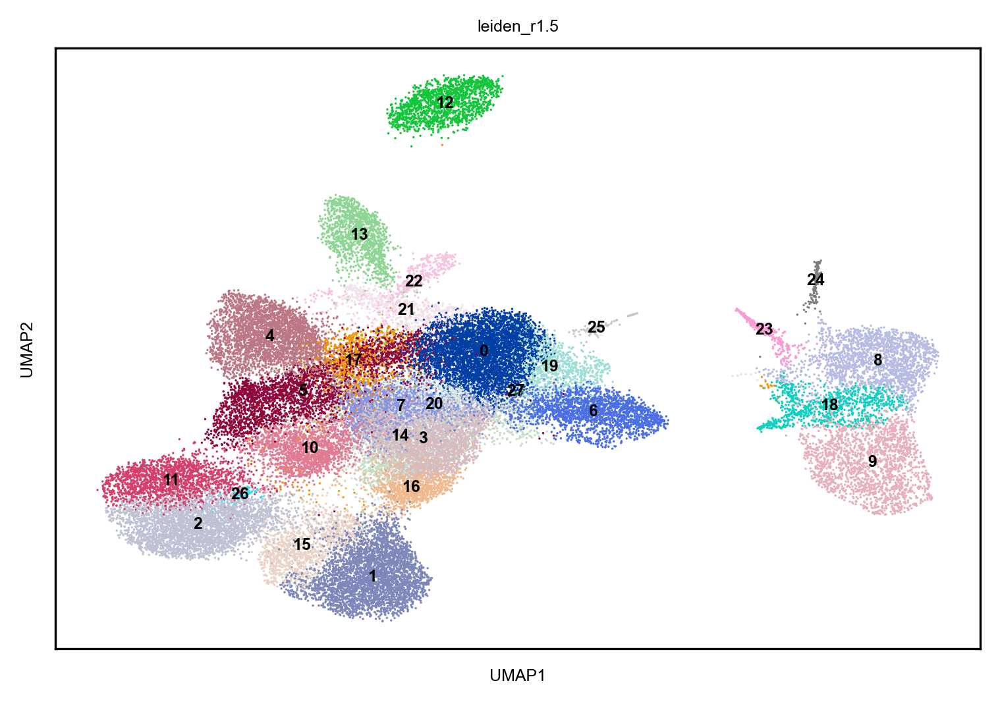

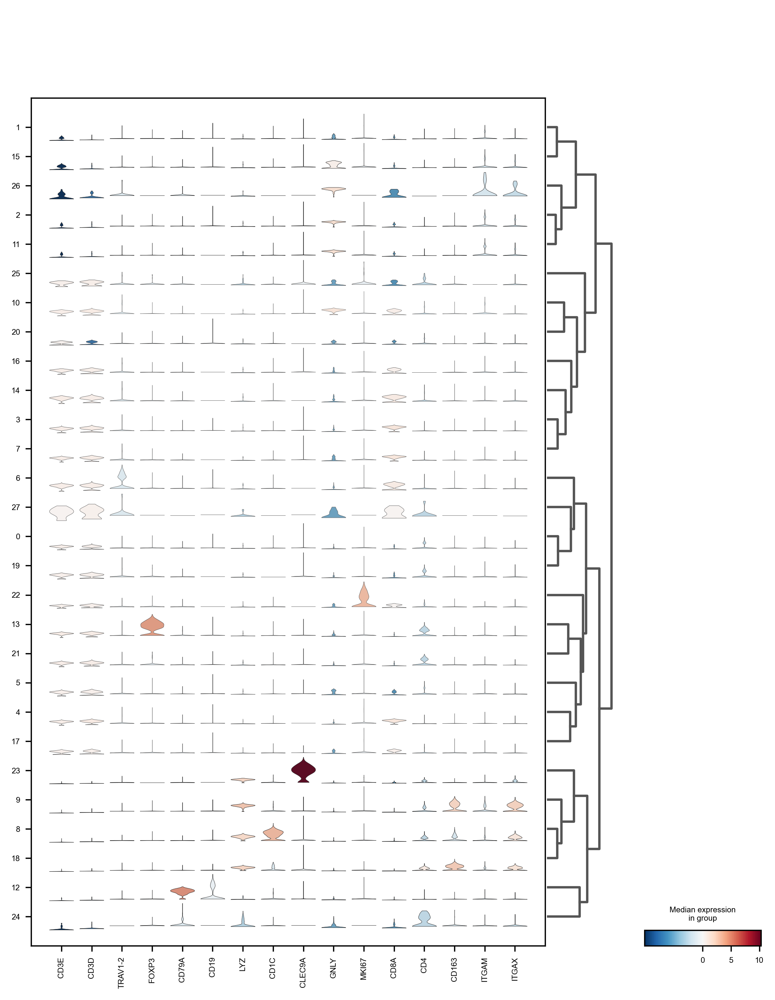

In [35]:
for resolution in [1.0, 1.2, 1.5]:
    sc.tl.leiden(adata, resolution=resolution, key_added=f"leiden_r{resolution}", random_state=0)
    
    with warnings.catch_warnings():
        warnings.simplefilter(action='ignore', category=pd.errors.PerformanceWarning)
        sc.tl.rank_genes_groups(adata, f"leiden_r{resolution}", method='wilcoxon', use_raw=True, key_added=f"leiden_r{resolution}_wilcoxon")

        dedf_leiden = sc.get.rank_genes_groups_df(adata,group=None, key=f"leiden_r{resolution}_wilcoxon")
        dedf_leiden.drop("pvals", axis=1, inplace=True)
        dedf_leiden = dedf_leiden[dedf_leiden["pvals_adj"] < 0.05]
    
    with pd.ExcelWriter(f"scRNA-seq/Redone22/CD45/DGE/leiden_r{resolution}.xlsx") as writer:
        for cluster_id in dedf_leiden.group.unique():
            df_sub_cl = dedf_leiden[dedf_leiden.group == cluster_id].copy()
            df_sub_cl.to_excel(writer, sheet_name=f"c{cluster_id}")

    del df_sub_cl
    del dedf_leiden
    
    sc.pl.umap(adata, color=[f"leiden_r{resolution}"], legend_loc="on data", save=f"_leiden_r{resolution}.pdf", title=f"leiden_r{resolution}")
    plt.show()
    
    leiden_counts = adata.obs[f"leiden_r{resolution}"].value_counts()
    leiden_counts.to_csv(f"scRNA-seq/Redone22/CD45/leiden_r{resolution}_cluster_counts.csv")
    adata.obs.groupby(["Patient", f"leiden_r{resolution}"]).count()["Sample"].to_csv(f"scRNA-seq/Redone22/CD45/leiden_r{resolution}_cluster_counts_perPatient.csv")
    
    
    sc.pl.stacked_violin(adata, plot_genes, groupby=f"leiden_r{resolution}", dendrogram=True, use_raw=False, 
                         vcenter=0, cmap="RdBu_r", save=f"leiden_r{resolution}.pdf")